# Homework 5 - Implementation of fixation detection algorithm

In [1]:
# %pip install pandas
# %pip freeze > requirements.txt

In [2]:
#%pip install -r requirements.txt
#%pip install seaborn
#%pip install matplotlib

## Imports and useful definitions

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import datetime
import PIL
import seaborn as sb

In [4]:
DATA_PATH = "./data/"
VERBOSE = False

In [5]:
data_file = "yarbus_complete_data.csv"
image_file = "unexpected_visitor.png"

## Data cleaning
For cleaning the data, we need to erase the following samples:
- Samples with negative values on `x` or `y` (blinks fall under this category)
- Erase values that are outside the screen box (assuming that we have a normal laptop screen, the resolution will probably be 2560x1440 as same size of the unexpected_visitor.png)
- Erase values with `validity` param set to "Invalid"

In [6]:
dfraw = pd.read_csv(DATA_PATH + data_file)
print("Number of rows:", len(dfraw))
dfraw.head(2)

Number of rows: 1998


,x,y,validity,timestamp_us,task
0,1407.382080,479.778687,Valid,1863999707017,free_viewing
1,1407.162842,480.453064,Valid,1863999737161,free_viewing


In [7]:
dfraw.describe()

,x,y,timestamp_us
count,1998.000000,1998.000000,1.998000e+03
mean,1334.171522,615.940916,1.864039e+12
std,449.276723,236.911953,2.235188e+07
min,-2560.000000,-1440.000000,1.864000e+12
25%,1027.438049,477.574417,1.864020e+12
50%,1346.011780,590.457428,1.864039e+12
75%,1723.777740,737.971069,1.864058e+12
max,1989.302856,1167.780518,1.864075e+12


In [8]:
df_noinvalid = dfraw[dfraw["validity"] == "Valid"]
print("Number of rows:", len(df_noinvalid))

Number of rows: 1992


In [9]:
dfpos = df_noinvalid[df_noinvalid['x'] >= 0]
dfpos = dfpos[dfpos['y'] >= 0]
print("Number of rows:", len(dfpos))

Number of rows: 1992


In [10]:
# screen_size_x = 1920
# screen_size_y = 1080
screen_size_x = 2560
screen_size_y = 1440

In [11]:
dfpos = dfpos[dfpos['x'] < screen_size_x]
dfpos = dfpos[dfpos['y'] < screen_size_y]
print("Number of rows:", len(dfpos))

Number of rows: 1992


In [12]:
dfcleaned = dfpos

We will also convert the timestamp to seconds, and use as a reference the start from the recording. However, this needs to be done by each task.

In [13]:
dfcleaned["total_time_s"] = dfcleaned["timestamp_us"]*1e-6

In [14]:
tasks = [
    "free_viewing",
    "estimate_wealth",
    "age_estimation",
    "activity",
    "remember_clothes",
    "furniture"
]

In [15]:
dftasks = {}
for t in tasks:
    dft = dfcleaned[dfcleaned["task"] == t].copy()
    start_time = dft["total_time_s"].min()
    dft["time"] = dft["total_time_s"] - start_time
    dftasks[t] = dft[["x", "y", "time"]]
    print(f'Task: {t}; Start time: {start_time:.3f}; Total duration: {dft["time"].max():.3f}')

Task: free_viewing; Start time: 1863999.707; Total duration: 10.029
Task: estimate_wealth; Start time: 1864015.052; Total duration: 10.029
Task: age_estimation; Start time: 1864028.223; Total duration: 10.029
Task: activity; Start time: 1864040.578; Total duration: 10.029
Task: remember_clothes; Start time: 1864052.812; Total duration: 10.029
Task: furniture; Start time: 1864065.319; Total duration: 10.029


In [16]:
dftasks["free_viewing"].describe()

,x,y,time
count,333.000000,333.000000,333.000000
mean,1218.311977,515.628863,5.014487
std,303.683614,115.865344,2.908144
min,883.797974,406.039337,0.000000
25%,916.608582,425.293945,2.507356
50%,1209.912598,479.100128,5.014372
75%,1355.685425,570.452881,7.521479
max,1954.022217,909.771667,10.028895


## Raw data visualization

### Plot of raw gaze data points  
Let's plot the cleaned raw data for different tasks on the unexpected_visitor image

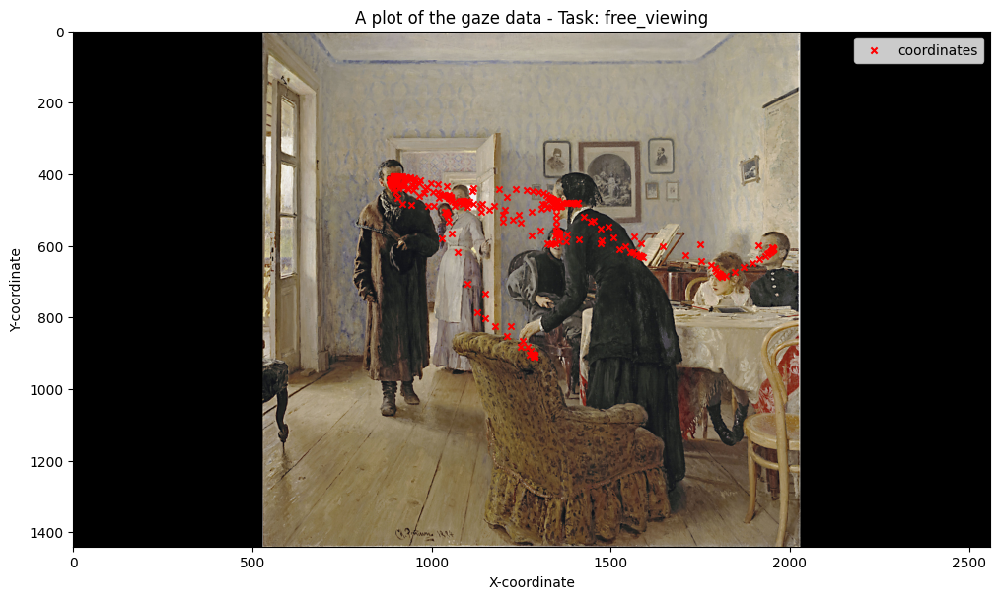

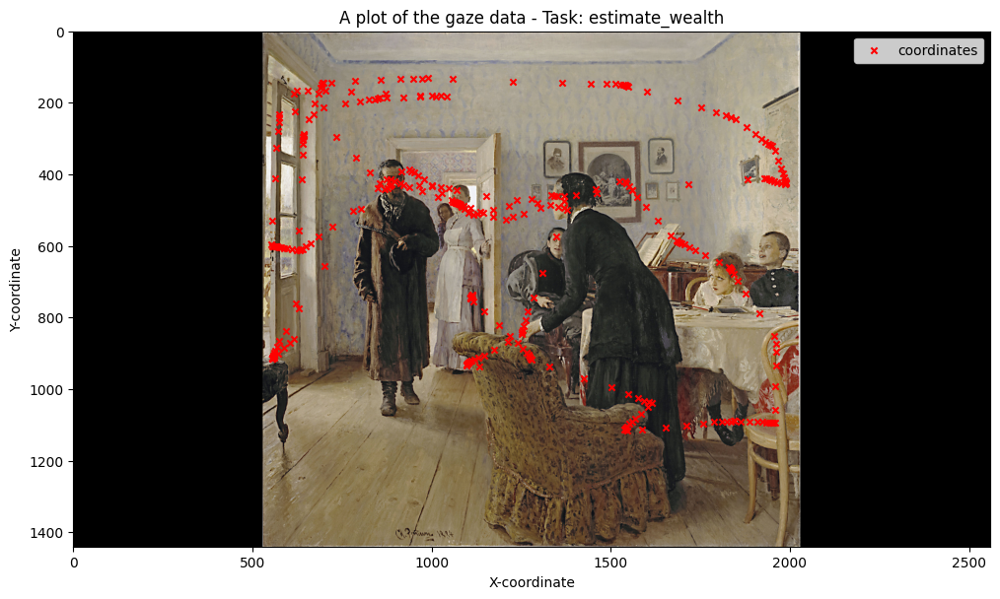

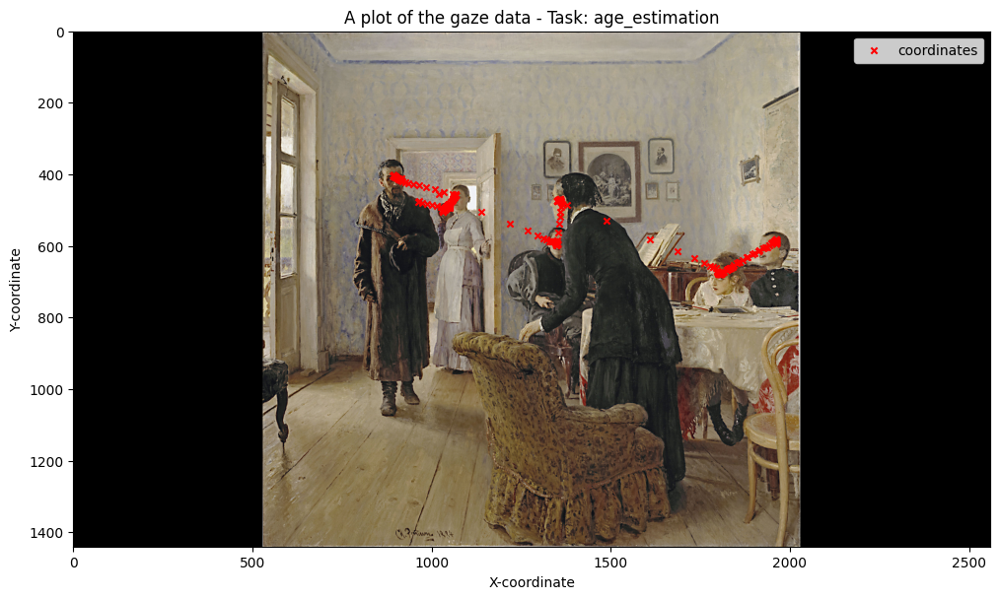

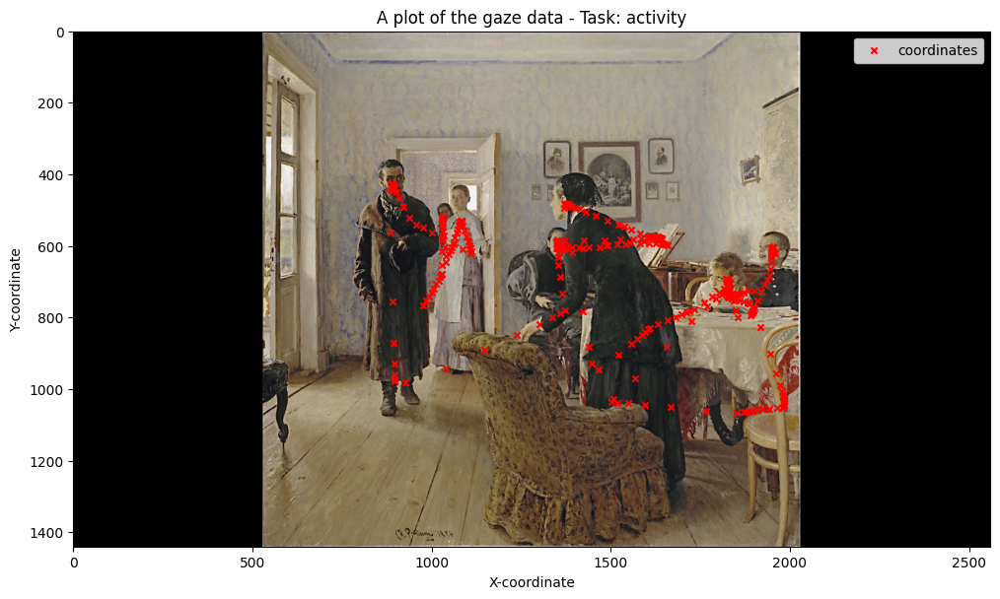

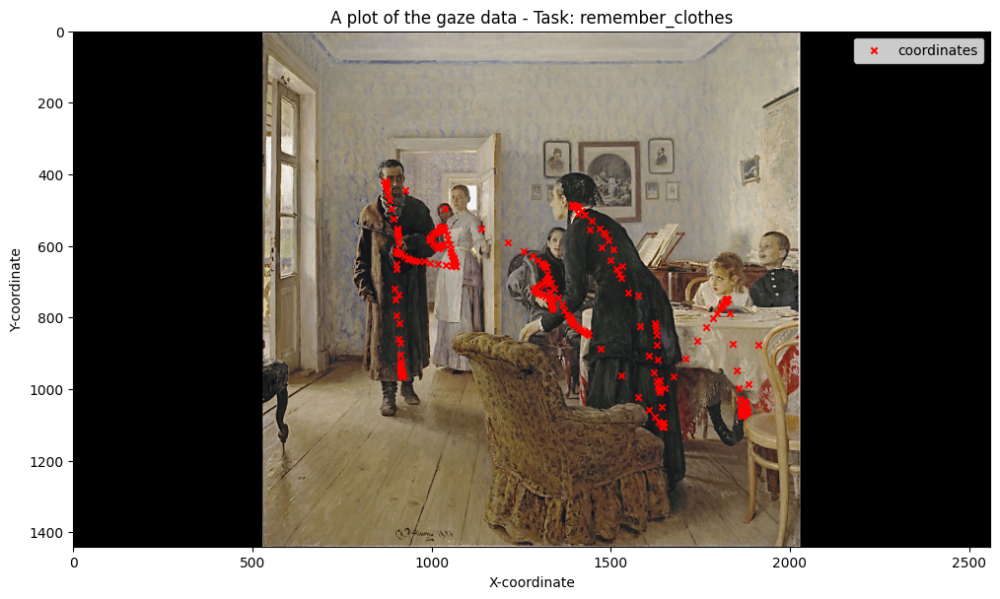

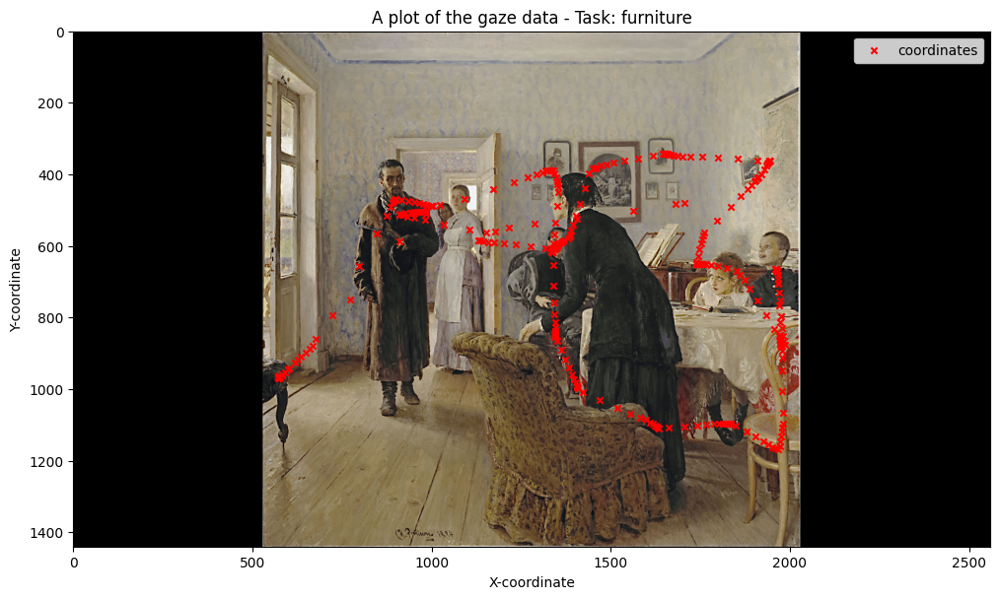

In [17]:
img = PIL.Image.open("data/unexpected_visitor.png") #load the image
for i in tasks:
    plt.figure(figsize=(12, 8))
    plt.imshow(img) #plot the image
    plt.scatter(dftasks[i]["x"], dftasks[i]["y"] ,c="red", marker='x', label='coordinates', s=20) #plot the coordinates
    plt.title(f"A plot of the gaze data - Task: {i}")
    # plt.xlim(550,1920)#set the x axis limits
    plt.xlim(0,2560)#set x axis limits
    plt.ylim(1440,0)#set y axis limits
    # plt.xticks([])
    # plt.yticks([])
    plt.legend()
    plt.xlabel("X-coordinate")
    plt.ylabel("Y-coordinate")
    plt.show()

The red dots indicate the coordinates of gaze points of the observer.

### Heatmap of the gaze data
Now, we can visualize the gaze data using a heatmap.

Here you can see the heatmaps corresponding to the gaze data. The more red areas indicate higher gaze density and  the more blue areas indicate lower gaze density.

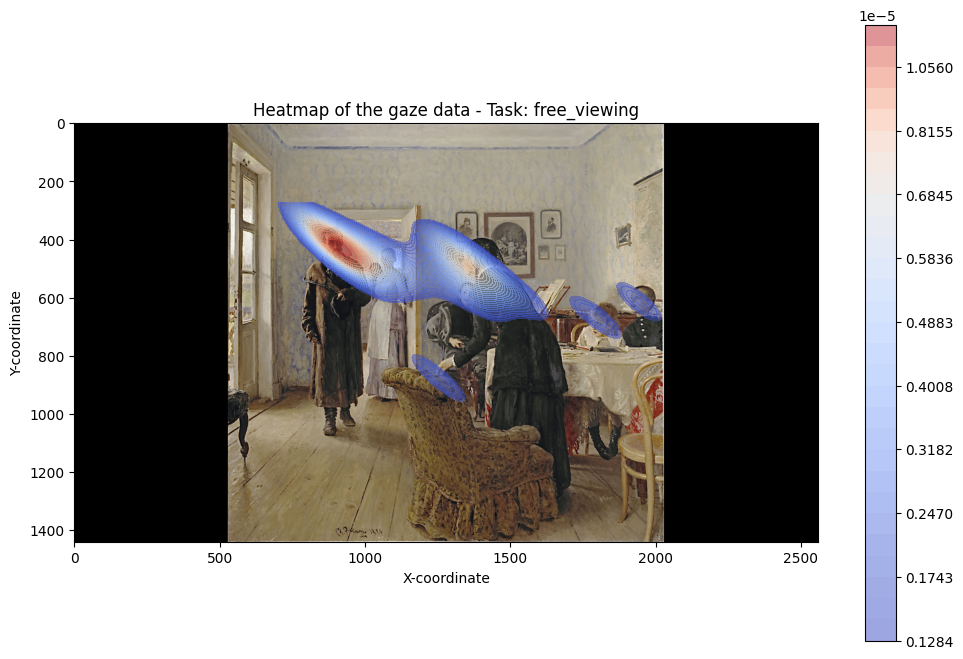

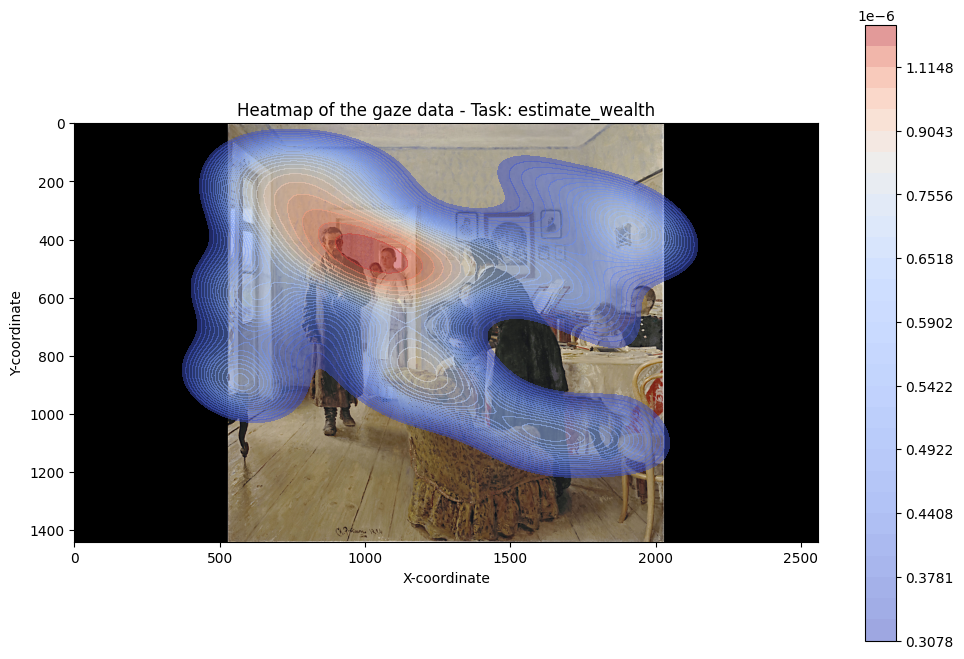

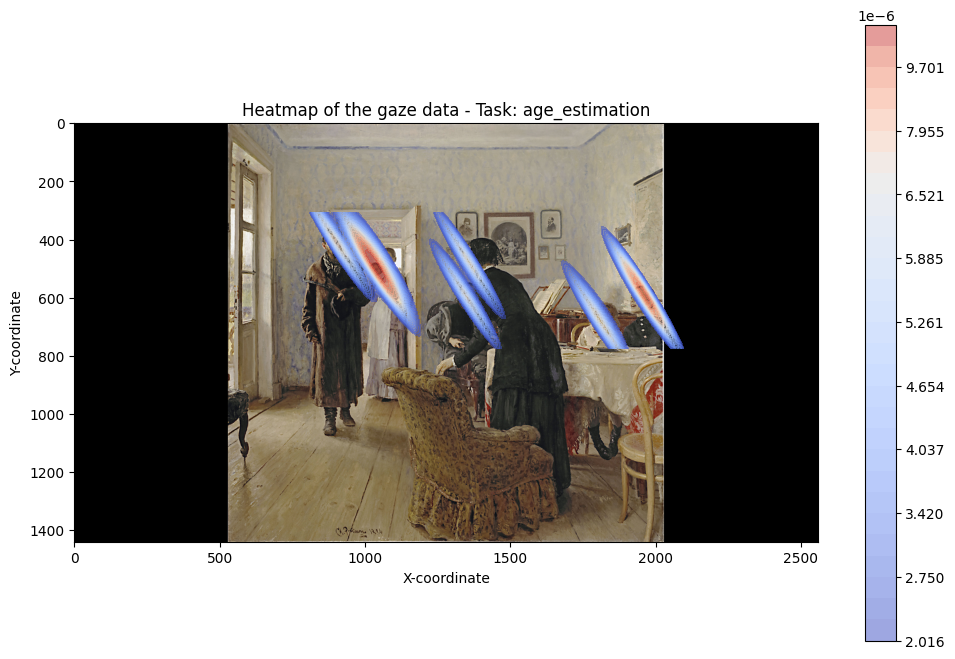

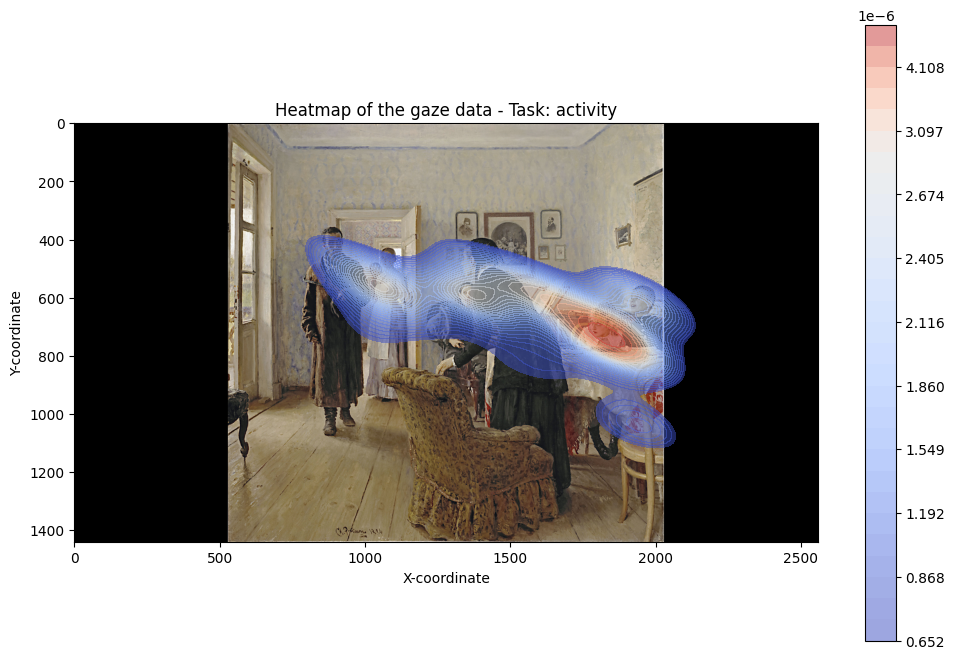

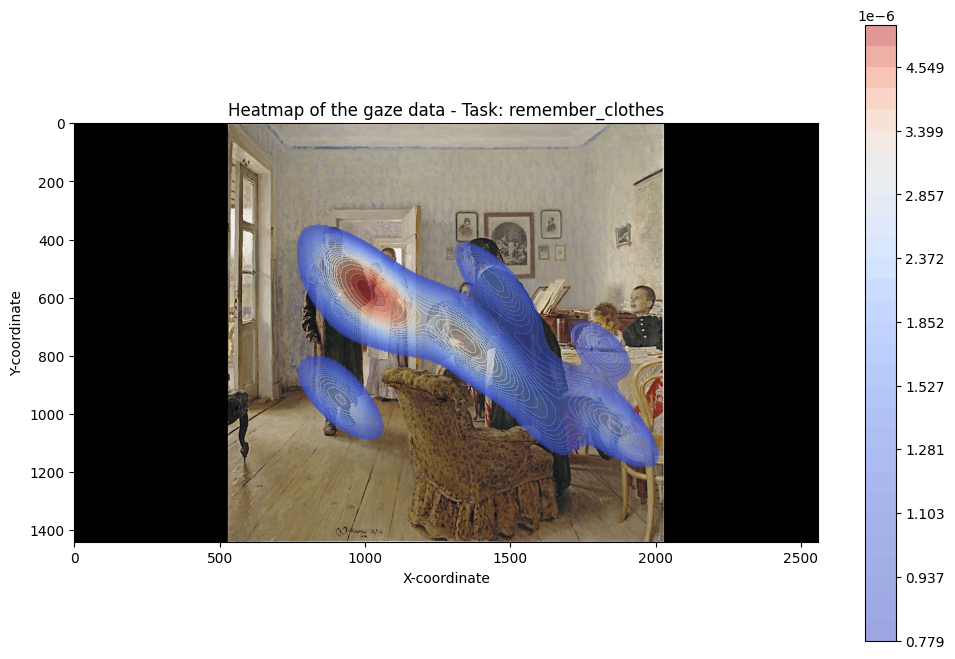

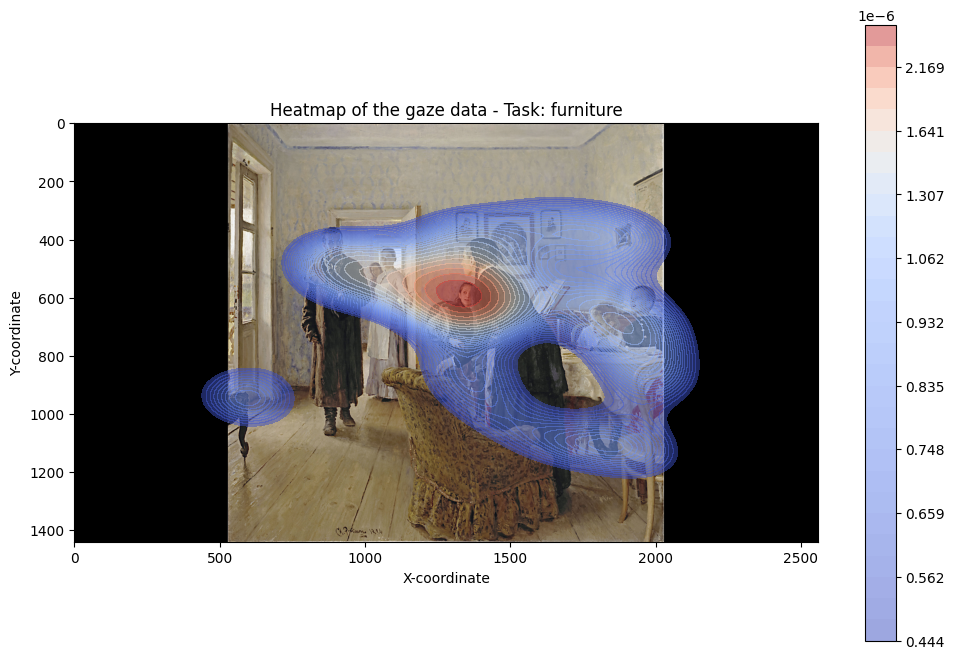

In [18]:
for i in tasks:
    plt.figure(figsize=(12, 8))
    plt.imshow(img,alpha=1)#plot the image
    sb.kdeplot(x=dftasks[i]["x"],y=dftasks[i]["y"], fill=True,thresh=0.2, cbar=True, cmap="coolwarm",alpha=0.5,levels=30) #plot the heattmap
    plt.xlim(0,2560)#set x axis limits
    plt.ylim(1440,0)#set y axis limits
    plt.title(f"Heatmap of the gaze data - Task: {i}")
    plt.xlabel("X-coordinate")
    plt.ylabel("Y-coordinate")
    plt.show()

## Algorithms
We implemented two algorithms, I-DT and SMI.

### I-DT
The algorithm calculates the dispersion of data within a moving window and determines whether it qualifies as a fixation by comparing the dispersion and duration thresholds. For fixation data, it records the centroid coordinates, the start and end times of the fixation, and its duration.

Argument

- points: Raw data [timestamp_s, x, y]
- T_disp: The dispersion threshold
- T_dur: The duration threshold

Return

- fixation data [centroid of x coordinate, centroid of y coordinate, fixation start time, fixation end time, fixation duration time]

In [19]:
def detect_fixations(points, T_disp, T_dur):
    
    # Initialize fixation data
    fixations = []
    # initialize the moving window
    window_start = 0
    window_end = 0
    # data points
    n_points = len(points)
    
    while window_end < n_points:
        # calculate the moving window
        window_points = points[window_start:window_end + 1]
        x_max, x_min = np.max(window_points[:, 1]), np.min(window_points[:, 1])
        y_max, y_min = np.max(window_points[:, 2]), np.min(window_points[:, 2])
        # calculate the dispersion
        dispersion = (x_max - x_min) + (y_max - y_min)

        if dispersion <= T_disp:
            duration = (points[window_end, 0] - points[window_start, 0]) # calculate the duration and change to ms
            if duration <= T_dur:
                window_end += 1 # the window moves to the right
            else:
                # Calculate fixation properties
                centroid_x = np.mean(window_points[:, 1])
                centroid_y = np.mean(window_points[:, 2])
                fixation_start = points[window_start, 0]
                fixation_end = points[window_end - 1, 0]
                fixation_duration = (fixation_end - fixation_start) # calculate the fixation duration and change to ms
                fixations.append([centroid_x, centroid_y, fixation_start, fixation_end, fixation_duration]) # save the fixation datas
                window_start = window_end
        else:
            window_start += 1
            window_end = window_start

    return fixations

#### Parameters and execution


In [20]:
T_disp = 50  # the dispersion threshold 1° of visual angle
T_dur = 0.1# 100  # generally 100-200ms

In [21]:
dfs_fixations_idt = {}
for t in tasks:
    task_data = dftasks[t]
    # Filter data for the current task
    points = task_data[['time', 'x', 'y']].values

    # Detect fixations
    fixations = detect_fixations(points, T_disp, T_dur)
    dffixation = pd.DataFrame(fixations, columns=['x', 'y', 'time_start', 'time_end', 'duration'])
    dfs_fixations_idt[t] = dffixation

#### Plot of some executions

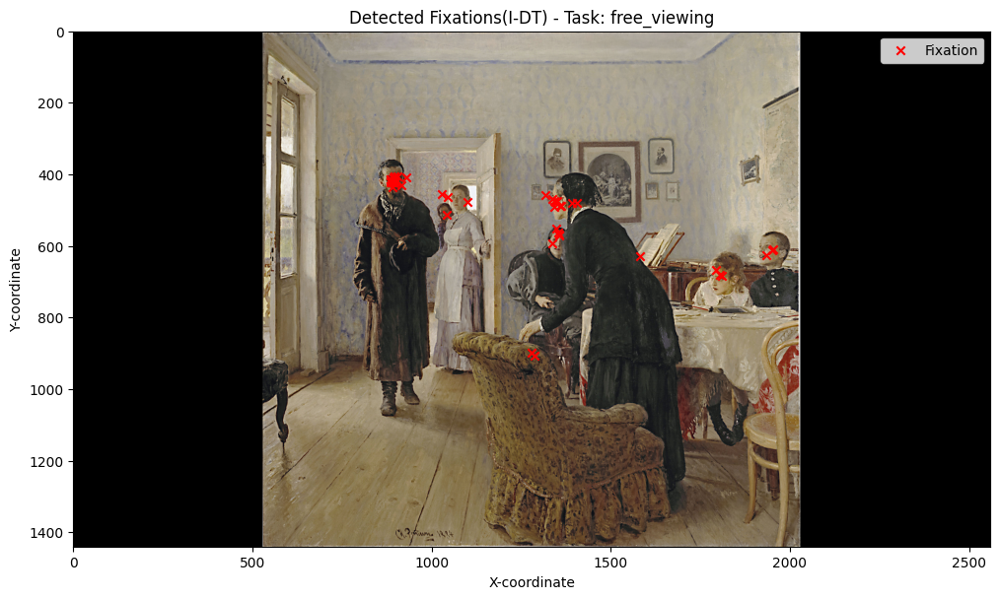

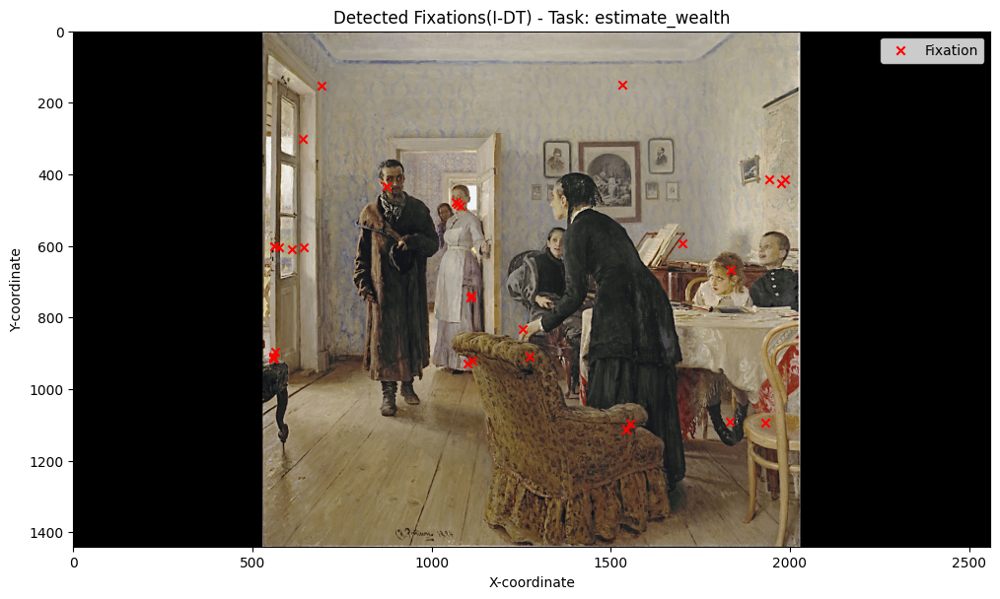

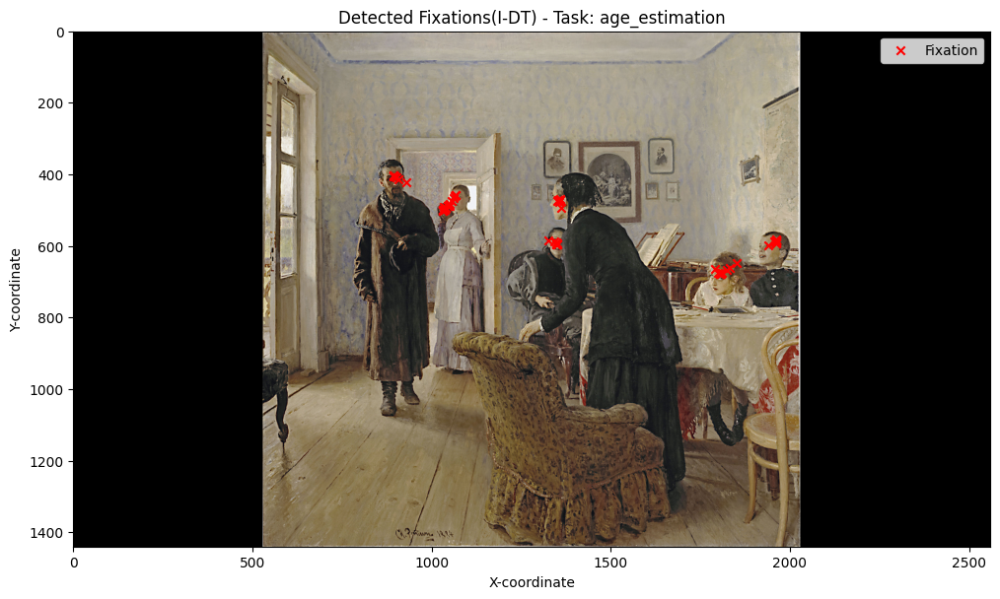

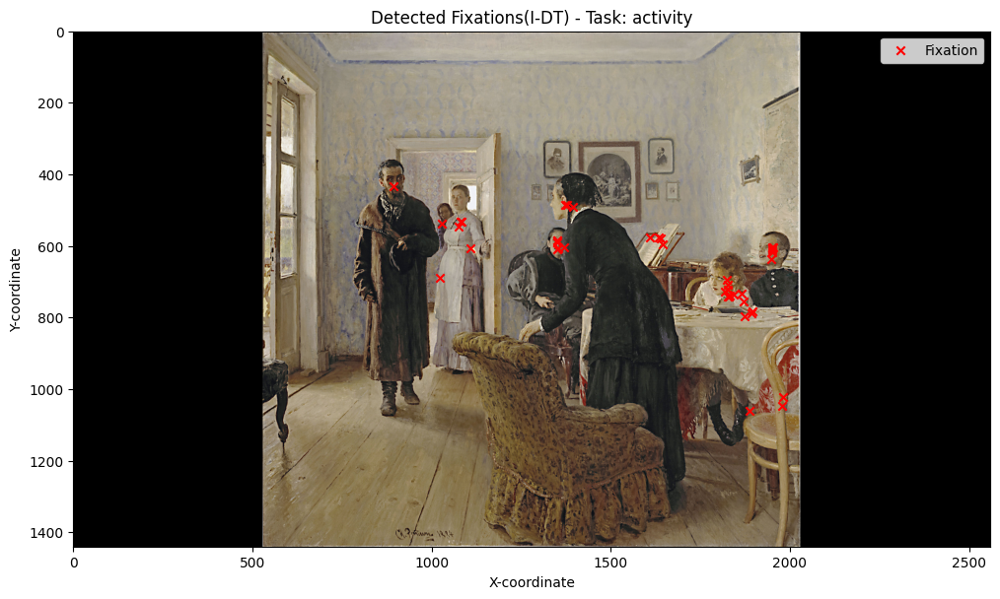

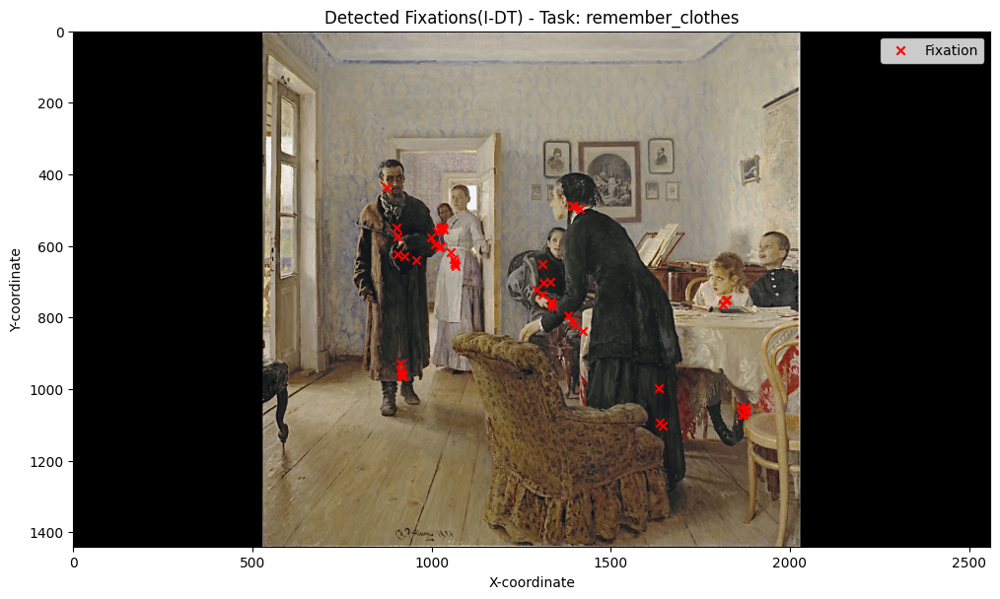

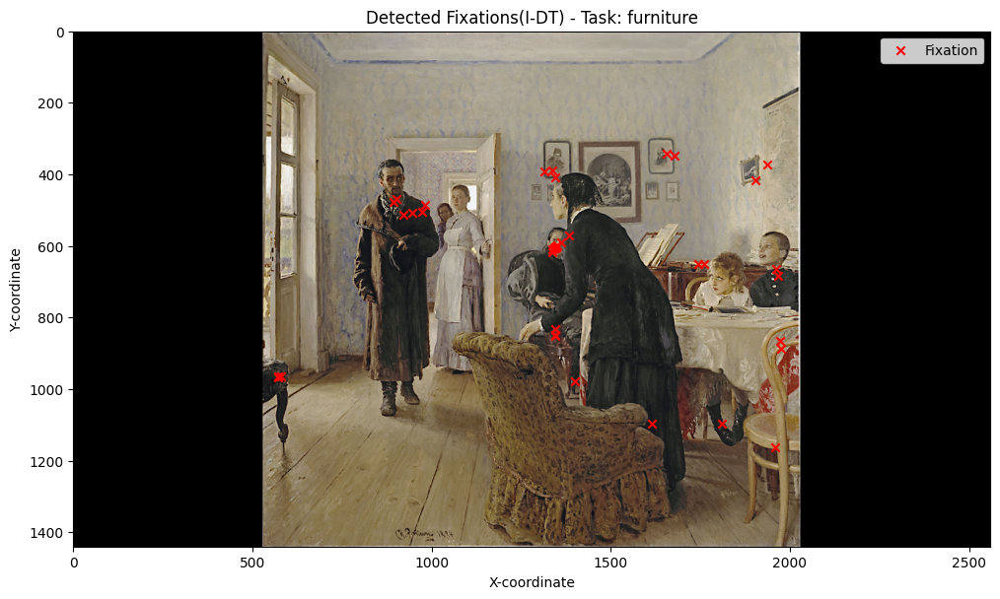

In [22]:
for task in tasks:
    fixations = np.array(dfs_fixations_idt[task])
    plt.figure(figsize=(12, 8))
    for i, fixation in enumerate(fixations):
        if i == 0: # Set the first legend only
            plt.scatter(fixation[0], fixation[1], color='red', marker='x', label='Fixation')
        else:
            plt.scatter(fixation[0], fixation[1], color='red', marker='x')
    
    plt.title(f"Detected Fixations(I-DT) - Task: {task}")
    plt.imshow(img) #plot the image
    plt.legend()
    plt.xlim(0,2560)#set x axis limits
    plt.ylim(1440,0)#set y axis limits
    plt.xlabel("X-coordinate")
    plt.ylabel("Y-coordinate")
    plt.show()
    # output_file = f"I-DT_{task}_plot.png"  # generate the png files
    # plt.savefig(output_file)  # save the figures

### SMI
The following code is the implementation of the SMI velocity algorithm. This algorithm receive the raw data of coordinates and calculate angular velocities. Then, detect saccades by applying a threshold to detect candidates of saccades, and a width of acceptable range where the saccade peak can be found.



#### How to calculate angular velocity
We assume eye position is on the center of the display, and distance between eye and display is 50 cm.
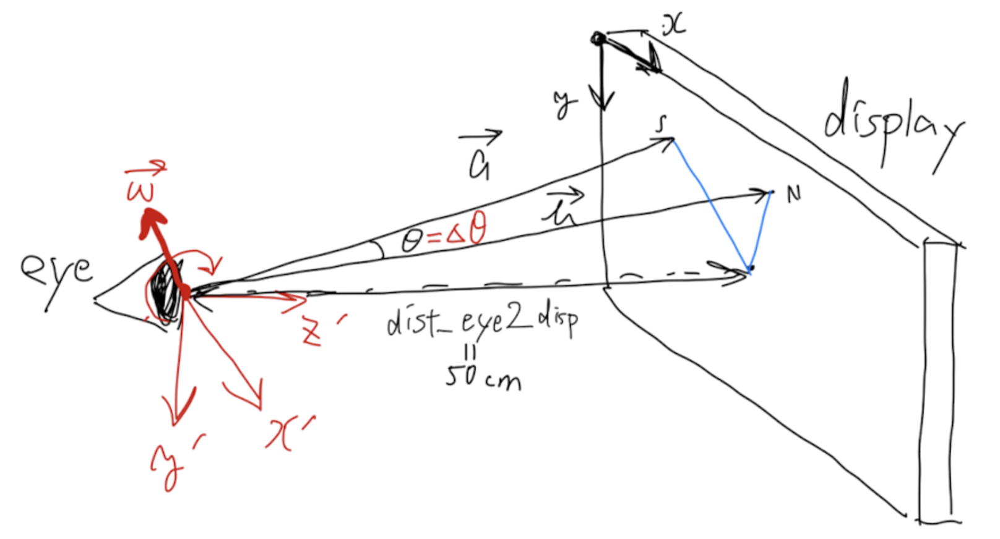


1. Cosine of the angle between vectors: 
$$ \cos \theta = \frac{\vec{a} \cdot \vec{b}}{|\vec{a}| |\vec{b}|} $$

2.	Angle $\theta$:

$$ \theta = \cos^{-1} \left( \frac{\vec{a} \cdot \vec{b}}{|\vec{a}| |\vec{b}|} \right) $$

3.	Magnitude of vector $\vec{a}$:

$$ |\vec{a}| = \sqrt{x_i^2 + y_i^2 + z_i^2} $$

4.	Magnitude of vector $\vec{b}$:

$$ |\vec{b}| = \sqrt{x_{i+1}^2 + y_{i+1}^2 + z_{i+1}^2} $$

5.	Angular velocity $\vec{\omega}$:

$$ \vec{\omega} = \frac{\Delta \theta}{\Delta t} = \frac{\Delta \theta}{t_2 - t_1} $$


In [23]:
# Utility code for plotting
def in_range(x, start, end):
    return x >= start and x <= end

def pairwise(iterable):
    a = iter(iterable)
    return zip(a, a)

def plot_middle(velocity, plot_data, threshold):
    data_x, data_y, out_x, out_y, threshold_lim, lines, centers = plot_data
    fig, ax = plt.subplots()
    ax.plot(velocity, "-o", alpha=0.8)
    ax.scatter(x=data_x, y=data_y, marker="x", color="r", s=100)
    ax.scatter(x=out_x, y=out_y, marker="x", color="k", s=100)
    for start, end in pairwise(threshold_lim):
        ax.axvspan(xmin=start, xmax=end, color="r", alpha=0.1)
    for start, end in pairwise(lines):
        ax.axvspan(xmin=start, xmax=end, color="g", alpha=0.3)
    for center in centers:
        ax.axvline(x=center, color="k", alpha=0.5)
    ax.axhline(y=threshold, color="k")
    return fig, ax

In [24]:
# Calculate angular velocity
def calc_vel(df: pd.DataFrame, dist_eye2disp, use_ang_velo=True, plot=False):
    xs = df["x"].to_numpy()
    ys = df["y"].to_numpy()
    times = df["time"].to_numpy()

    if use_ang_velo:  # Use angular veolocity
        if VERBOSE: print("Use angular velocity")
        #! assume eye position(x,y) is on the center of the display
        centerOfDisp_x = screen_size_x / 2
        centerOfDisp_y = screen_size_y / 2
        # Conver coordination from that top left of the display is (0,0)
        # // to that center of the display is (0,0,dist_eye2disp)
        converted_xs = xs + centerOfDisp_x
        converted_ys = ys + centerOfDisp_y
        converted_zs = np.zeros(len(converted_xs))
        converted_zs[:] = dist_eye2disp
        shift_xs = converted_xs[1:]
        shift_ys = converted_ys[1:]
        shift_zs = converted_zs[1:]
        shift_times = times[1:]

        # theta = arccos{innerProduct(vector_a, vector_b) / |a||b|}
        dist_a = np.sqrt(
            (converted_xs[:-1]) ** 2
            + (converted_ys[:-1]) ** 2
            + (converted_zs[:-1]) ** 2
        )  # |a|
        dist_b = np.sqrt((shift_xs) ** 2 + (shift_ys) ** 2 + (shift_zs) ** 2)  # |b|
        innerProduct_ab = np.sum(
            np.array(
                [
                    converted_xs[:-1] * shift_xs,
                    converted_ys[:-1] * shift_ys,
                    converted_zs[:-1] * shift_zs,
                ]
            ).T,
            axis=1,
        )  # innerProduct(vector_a, vector_b)
        deltaTheta = np.arccos(innerProduct_ab / (dist_a * dist_b))  # theta
    else:  # Use distance instead of angular velocity
        if VERBOSE: print("Use distance instead of angular velocity")
        shift_xs = xs[1:]
        shift_ys = ys[1:]
        shift_times = times[1:]
        deltaD = (
            (xs[:-1] - shift_xs) ** 2 + (ys[:-1] - shift_ys) ** 2
        ) ** 0.5  # calculate Euclidean distance
        deltaTheta = deltaD

    deltaTime = shift_times - times[:-1]
    velocity = deltaTheta / deltaTime
    if plot:
        plt.plot(range(0, len(velocity)), velocity)
    return velocity

In [25]:
def grouping_sac_cand(velocity, threshold):
    # funtion that detect saccade candidate according to threshold

    suc_or_other = velocity > threshold
    # Detect indexes that the value switch
    switch_indices = np.where(suc_or_other[:-1] != suc_or_other[1:])[0] + 1
    # Get head indexes of the each group
    group_start_indices = np.insert(switch_indices, 0, 0)
    # head of saccade
    suc_start_indices = group_start_indices[suc_or_other[group_start_indices]]
    
    group_lengths = np.diff(np.append(group_start_indices, len(suc_or_other)))
    suc_cand_lengths = group_lengths[suc_or_other[group_start_indices]]

    # handle saccade information with zipping
    sac_cand_info = zip(suc_start_indices, suc_cand_lengths)
    return sac_cand_info

def gen_sac_cand(sac_cand_info, eye_vel, width):
    # function that generate saccade candidate with width parameter

    # important things for process
    sac_cands = []
    non_saccade = []

    # not important so much, just for plot
    data_x = []
    data_y = []
    out_x = []
    out_y = []
    threshold_lim = []
    lines = []
    centers = []

    for start, length in sac_cand_info:
        start = int(start)
        length = int(length)
        length -= 1
        if length < 1:
            if VERBOSE: print("skip")
            continue
        sac_cand = eye_vel[start: start + length]  
        max_index = start + np.argmax(sac_cand)

        # center of saccade(candidate) period
        center = start + length / 2
        # Detect peaks over the fixation velocity threshold as candidates of saccades
        peak = np.max(sac_cand)
        # 
        cand_range = (center - width, center + width)

        # Consider the candidates as real saccades if their peak is 
        # within the saccade peak width from the center of the candidates. 
        if in_range(max_index, *cand_range):
            sac_cands.append((start, length))
        else:
            non_saccade.append((start, length))

        # data for plot
        lines.append(cand_range[0])
        lines.append(cand_range[1])
        threshold_lim.append(start)
        threshold_lim.append(start + length)
        centers.append(center)
        if in_range(max_index, *cand_range):
            data_x.append(max_index)
            data_y.append(peak)
        else:
            out_x.append(max_index)
            out_y.append(peak)
    return (
        (sac_cands, non_saccade),
        (data_x, data_y, out_x, out_y, threshold_lim, lines, centers),
    )

In [26]:
# classify data period
def classify_smi(
    df: pd.DataFrame,
    threshold,
    width,
    dist_eye2disp,
    use_ang_velo=True,
    plot=False,
):   
    # calculate angular velocity
    velocity = calc_vel(df, dist_eye2disp, use_ang_velo, plot)
    # get saccade candidate
    sac_cand_info = grouping_sac_cand(velocity, threshold)
    ((sac_cands, non_saccade), plot_data) = gen_sac_cand(
        sac_cand_info, velocity, width
    )

    # package it to DataFrame 
    df_result = df.copy()
    times = df_result["time"].to_numpy()
    df_result["label"] = "fixation"
    for start_sac, length in sac_cands:
        start_time = times[start_sac]
        end_time = times[start_sac + length]
        start = df_result["time"] >= start_time
        end = df_result["time"] <= end_time
        df_result.loc[start & end, "label"] = "saccade"

    if plot:
        plot_middle(velocity, plot_data, threshold)
    return df_result

#### Parameters and execution

In [27]:
# parameter setting
use_ang_velo = True  # True: angular velocity, False: distance velocity
dist_eye2disp = 50  # a # cm
width = 8
threshold = 0.015

In [28]:
# execution for all tasks
dfs_classified_smi = {}
for i in tasks:
    df = dftasks[i]
    df = classify_smi(
        df,
        threshold,
        width,
        dist_eye2disp,
        use_ang_velo=use_ang_velo,
        plot=False,
    )

    dfs_classified_smi[i] = df

#### Plotting classification results

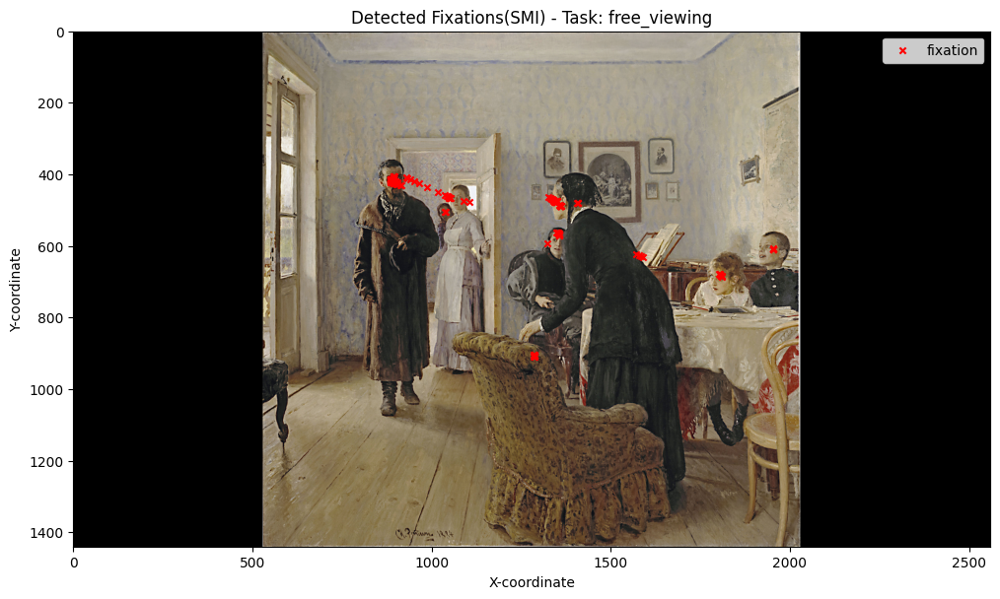

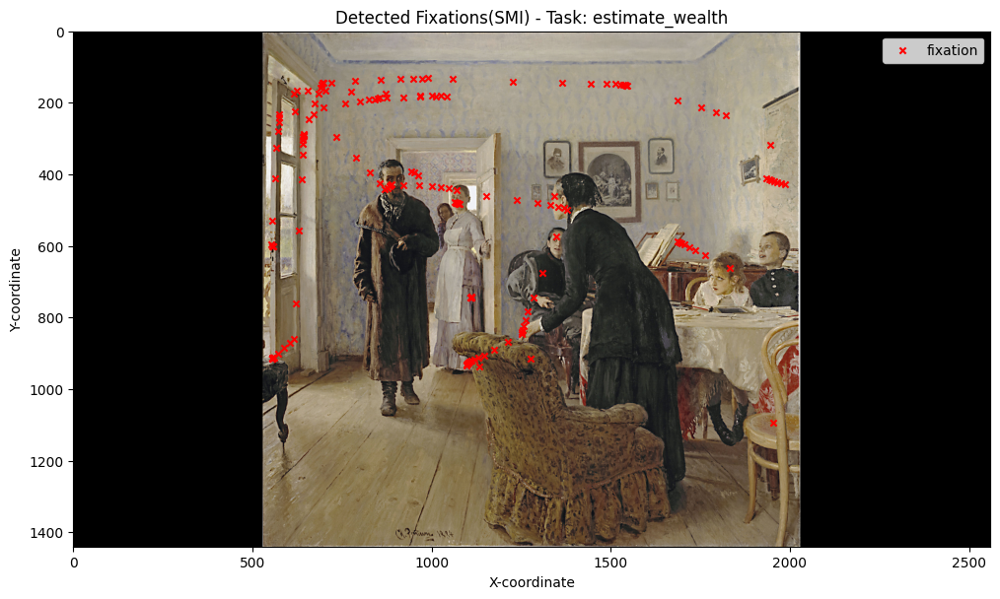

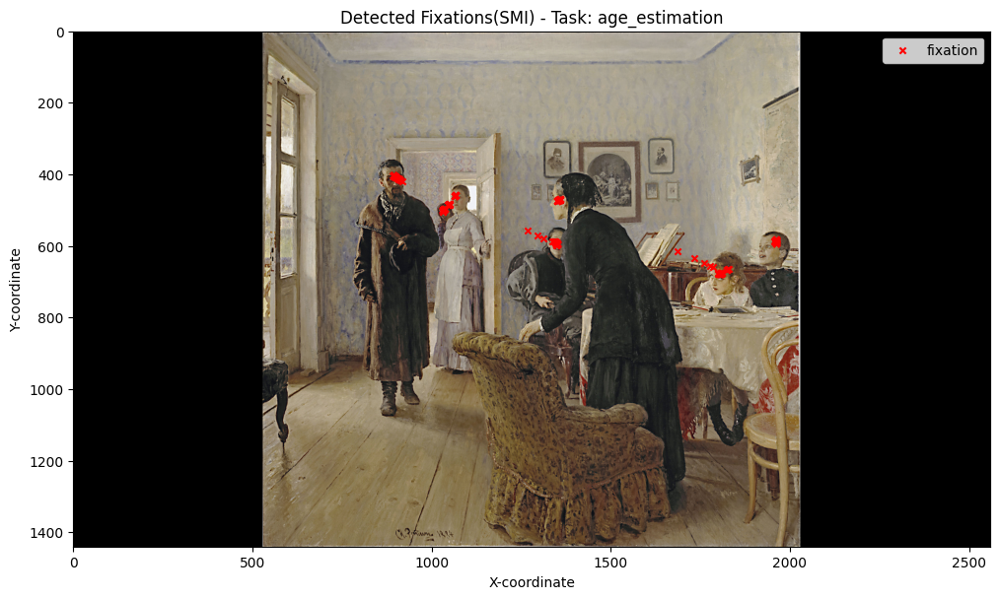

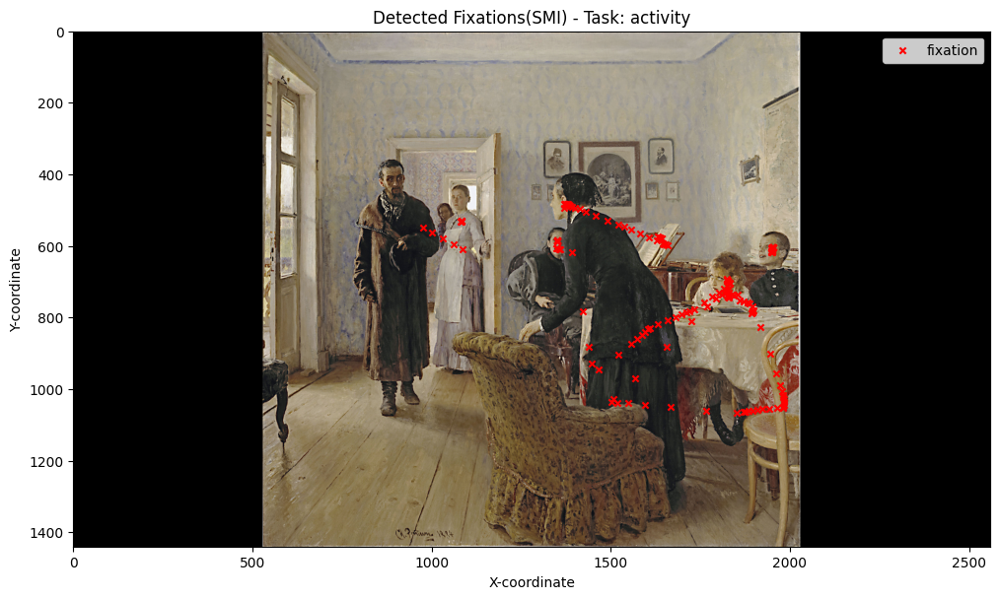

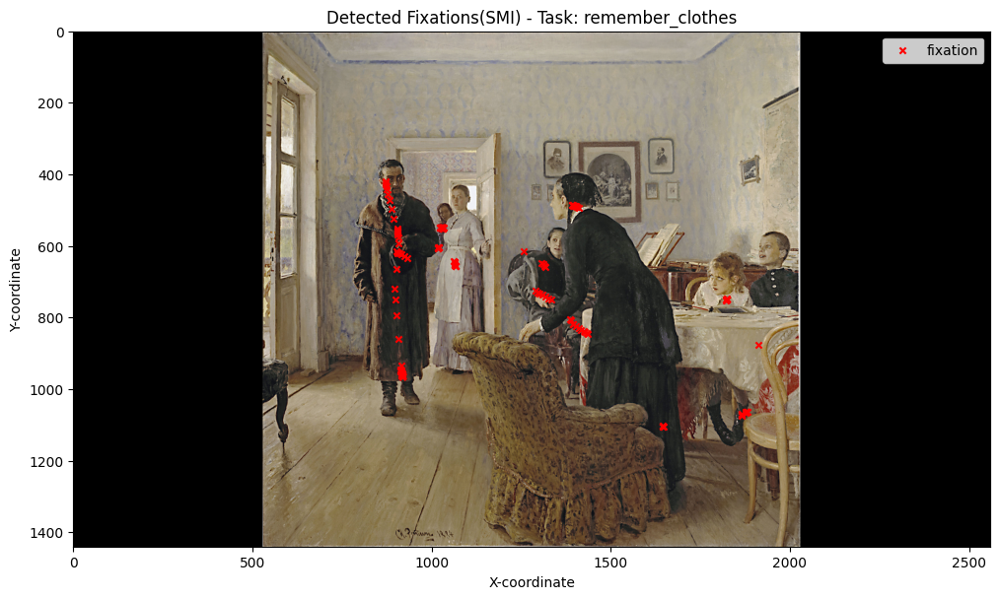

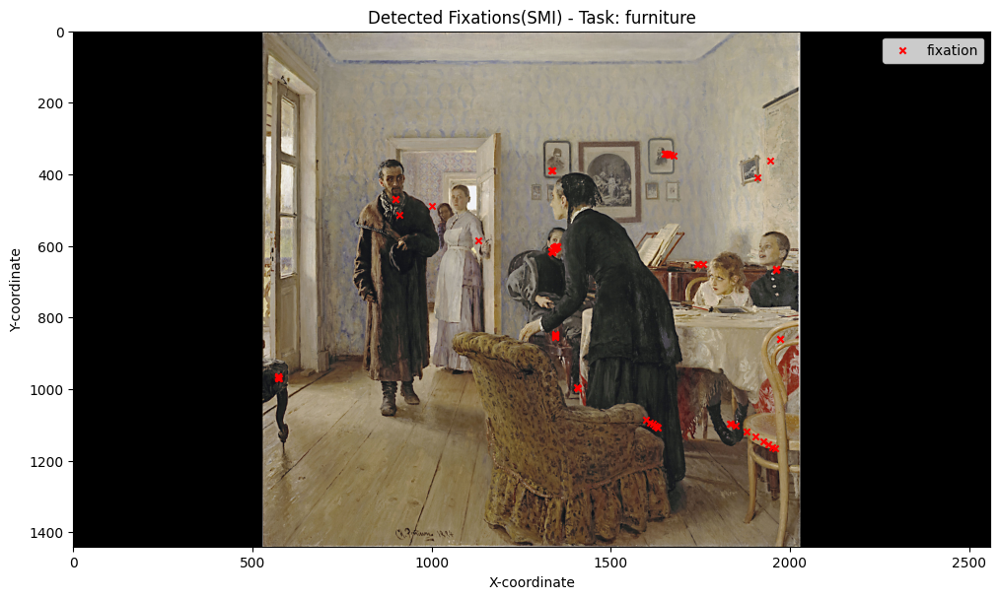

In [29]:
for t in tasks:
    df = dfs_classified_smi[t]
    plt.show()
    fixation = df[df["label"] == "fixation"]
    saccade = df[df["label"] == "saccade"]
    plt.figure(figsize=(12, 8))
    plt.imshow(img) #plot the unexpected visitors image
    plt.scatter(x=fixation["x"], y=fixation["y"], label="fixation", c="red", s=20, marker="x")
    plt.legend() 
    plt.title(f"Detected Fixations(SMI) - Task: {t}")
    plt.xlim(0,2560)#set x axis limits
    plt.ylim(1440,0)#set y axis limits
    plt.xlabel("X-coordinate")
    plt.ylabel("Y-coordinate")
    plt.show()

#### Data formatting

In [30]:
def convert_data_into_fixations(df : pd.DataFrame):
    array_ex = np.array(df)
    i = 0
    fixations = [] # The columns will be x, y, time_start, time_end, duration
    
    while i < len(array_ex):
        if array_ex[i][3] == 'saccade':
            i += 1
            continue
        else:
            j = i+1
            while j < len(array_ex) and array_ex[j][3] == 'fixation':
                j += 1
            # Now the range [i, j) is a fixation

            fix_point = array_ex[i:j]
            fixations.append(np.array([
                fix_point[:, 0].mean(), # x coordinate of the center of fixation
                fix_point[:, 1].mean(), # y coordinate of the center of fixation
                fix_point[0, 2],        # start time of the fixation
                fix_point[-1, 2],       # end time of the fixation
                fix_point[-1, 2] - fix_point[0, 2] # duration of the fixation
            ]))

            i = j
    dffixation = pd.DataFrame(fixations, columns=['x', 'y', 'time_start', 'time_end', 'duration'])
    return dffixation

In [31]:
dfs_fixations_smi = {}
for t in tasks:
    dfs_fixations_smi[t] = convert_data_into_fixations(dfs_classified_smi[t])

## Data analysis

We have calculated metrics such as the average duration of fixations, the average length of saccades, and the total number of fixations and saccades. Fixations are visualized as purple circles, where the size represent how long the eyes stayed focused on each point, while saccades are displayed as cyan lines connecting the fixation points that trace the eye’s movement path. The visualization makes it easier to see where attention was directed and how it shifted over time.

### I-DT


Metrics for free_viewing Task:
                                Metric   Value
0  Average Fixation Duration (seconds)    0.09
1      Average Saccade Length (pixels)  119.06
2            Total Number of Fixations      50
3    Total Scanpath Duration (seconds)    9.70


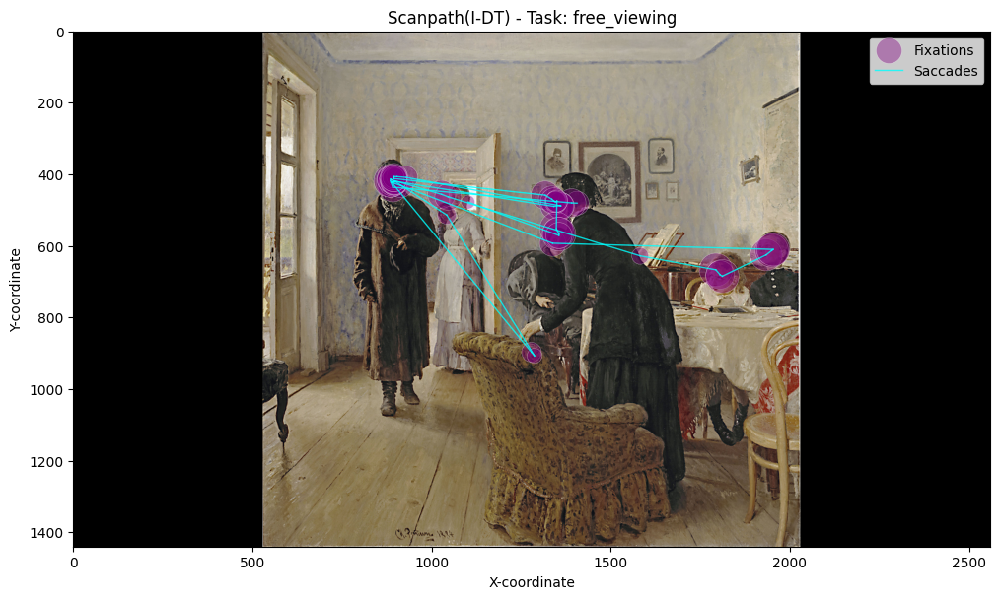


Metrics for estimate_wealth Task:
                                Metric   Value
0  Average Fixation Duration (seconds)    0.09
1      Average Saccade Length (pixels)  261.31
2            Total Number of Fixations      30
3    Total Scanpath Duration (seconds)    9.97


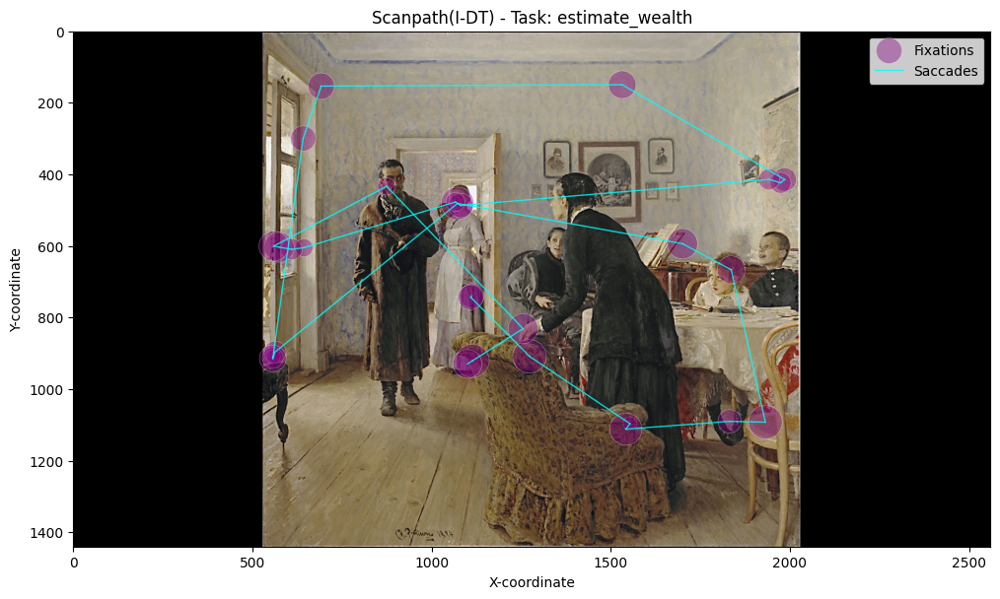


Metrics for age_estimation Task:
                                Metric  Value
0  Average Fixation Duration (seconds)   0.09
1      Average Saccade Length (pixels)  25.17
2            Total Number of Fixations     72
3    Total Scanpath Duration (seconds)   9.85


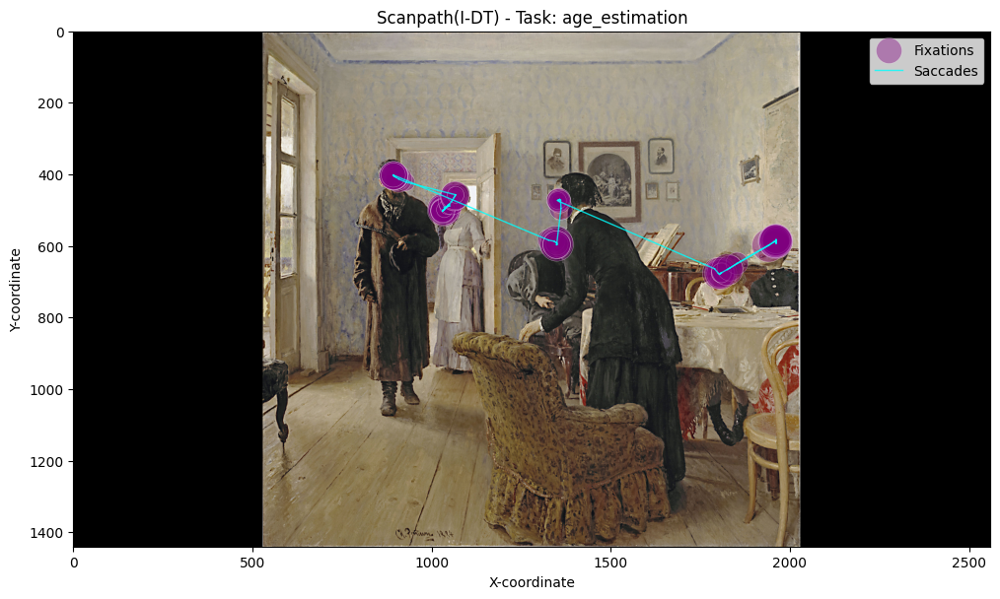


Metrics for activity Task:
                                Metric  Value
0  Average Fixation Duration (seconds)   0.09
1      Average Saccade Length (pixels)  97.48
2            Total Number of Fixations     43
3    Total Scanpath Duration (seconds)   9.76


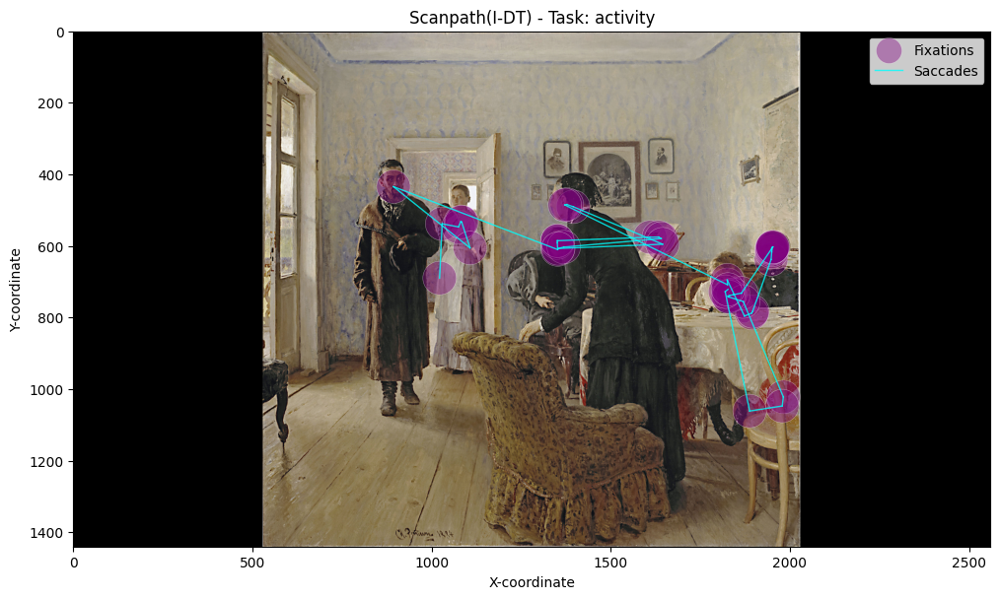


Metrics for remember_clothes Task:
                                Metric  Value
0  Average Fixation Duration (seconds)   0.09
1      Average Saccade Length (pixels)  75.79
2            Total Number of Fixations     59
3    Total Scanpath Duration (seconds)   9.88


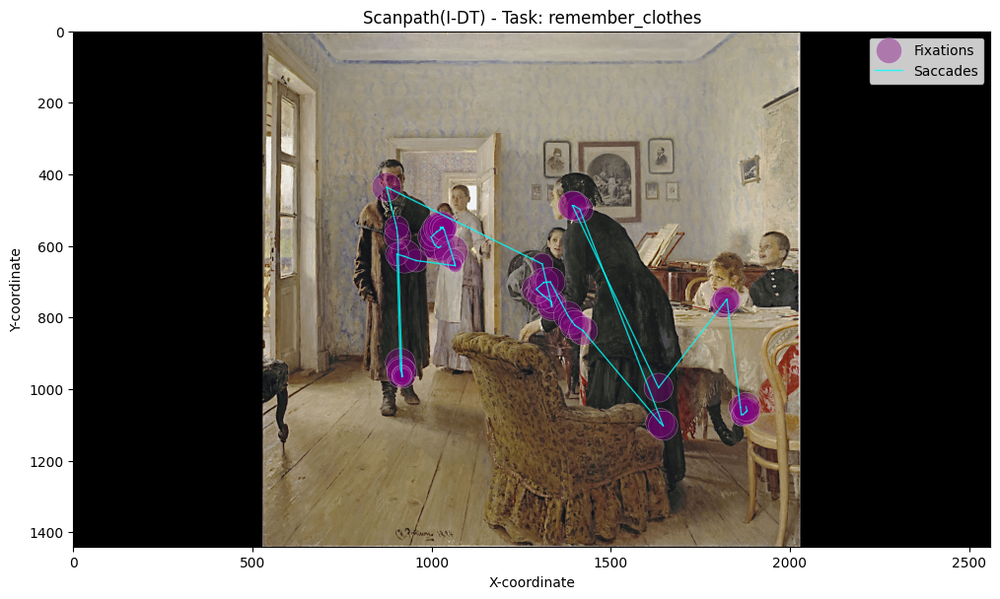


Metrics for furniture Task:
                                Metric   Value
0  Average Fixation Duration (seconds)    0.09
1      Average Saccade Length (pixels)  113.99
2            Total Number of Fixations      42
3    Total Scanpath Duration (seconds)    9.33


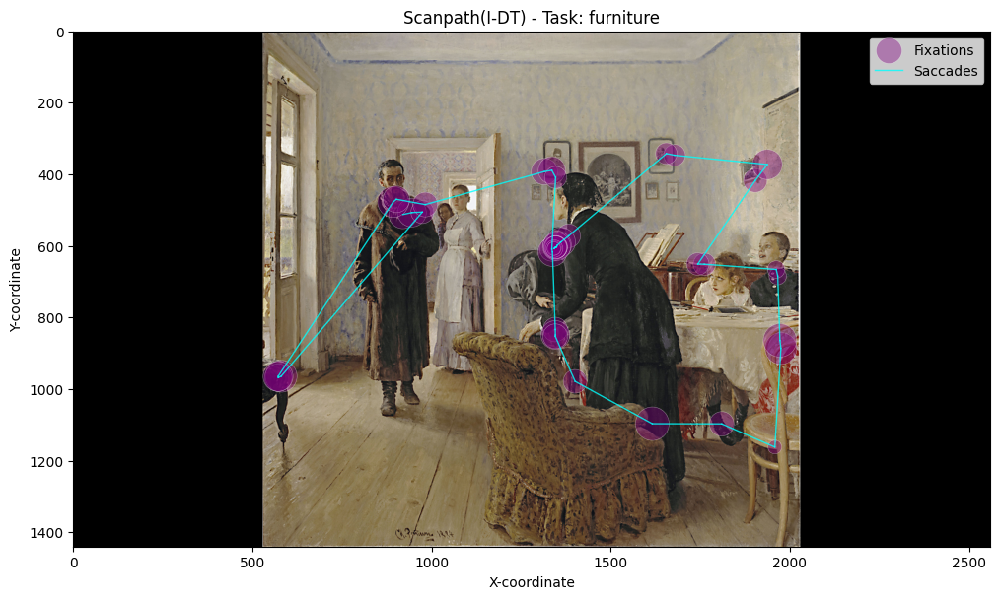

In [32]:
for task_name, df in dfs_fixations_idt.items():

    # 1. Calculate Average Fixation Duration
    average_fixation_duration = df['duration'].mean()

    # 2. Calculate Saccade Lengths (distance between consecutive fixations)
    x_diff = df['x'].diff().iloc[1:]  # Differences in x coordinates
    y_diff = df['y'].diff().iloc[1:]  # Differences in y coordinates
    saccade_lengths = np.sqrt(x_diff**2 + y_diff**2)  # Euclidean distance between consecutive fixations

    # 3. Calculate the Average Saccade Length
    average_saccade_length = saccade_lengths.mean()

    # 4. Calculate Total Number of Fixations
    total_fixations = len(df)

    # 5. Calculate Total Scanpath Duration
    total_scanpath_duration = df['time_end'].max() - df['time_start'].min()

    # 6. Prepare metrics for display
    metrics = {
        "Metric": [
            "Average Fixation Duration (seconds)",
            "Average Saccade Length (pixels)",
            "Total Number of Fixations",
            "Total Scanpath Duration (seconds)"
        ],
        "Value": [
            f"{average_fixation_duration:.2f}",
            f"{average_saccade_length:.2f}",
            total_fixations,
            f"{total_scanpath_duration:.2f}"
        ]
    }

    metrics_df = pd.DataFrame(metrics)
    print(f"\nMetrics for {task_name} Task:")
    print(metrics_df)

    min_time = df['duration'].min()
    max_time = df['duration'].max()

    # Normalize fixation durations to assign circle sizes proportionally
    size_range = (100, 600)
    df['size'] = (df['duration'] - min_time) / (max_time - min_time) * (size_range[1] - size_range[0]) + size_range[0]

    # # Range for transparency of circle
    # alpha_range = (0.4, 0.8)
    # df['alpha'] = (df['duration'] - min_time) / (max_time - min_time) * (alpha_range[1] - alpha_range[0]) + alpha_range[0]

    # Plotting Fixations
    plt.figure(figsize=(12, 8))
    plt.imshow(img)  # Ensure `img` is the image you're using for the background

    # Scatter plot for fixations
    # plt.scatter(df['x'], df['y'], label='Fixations', marker='o', s=df['size'], color='purple', alpha=df['alpha'], edgecolor='white', linewidth= 0.4)
    plt.scatter(df['x'], df['y'], label='Fixations', marker='o', s=df['size'], color='purple', alpha=0.4, edgecolor='white', linewidth= 0.4)

    # Plot saccades (lines between consecutive fixations)
    plotted_saccades = False  # Flag to add saccades label only once
    for i in range(1, len(df)):
        x1, y1 = df['x'].iloc[i - 1], df['y'].iloc[i - 1]
        x2, y2 = df['x'].iloc[i], df['y'].iloc[i]
        if not plotted_saccades:  # Add label for saccades only once
            plt.plot([x1, x2], [y1, y2], color='cyan',linestyle='-', linewidth=1, alpha=0.8, label='Saccades')
            plotted_saccades = True
        else:
            plt.plot([x1, x2], [y1, y2], color='cyan', linestyle='-', linewidth=1, alpha=0.8)

    # Titles and labels
    # plt.title(f'Fixation Visualization for {task_name} Task')
    plt.title(f"Scanpath(I-DT) - Task: {task_name}")
    plt.xlabel('X-coordinate')
    plt.ylabel('Y-coordinate')
    plt.xlim(0,2560)#set x axis limits
    plt.ylim(1440,0)#set y axis limits
    plt.legend()
    plt.grid(False)  
    plt.axis('on') 
    plt.show()

### SMI


Metrics for free_viewing Task:
                                Metric   Value
0  Average Fixation Duration (seconds)    0.24
1      Average Saccade Length (pixels)  348.04
2            Total Number of Fixations      18
3    Total Scanpath Duration (seconds)   10.03


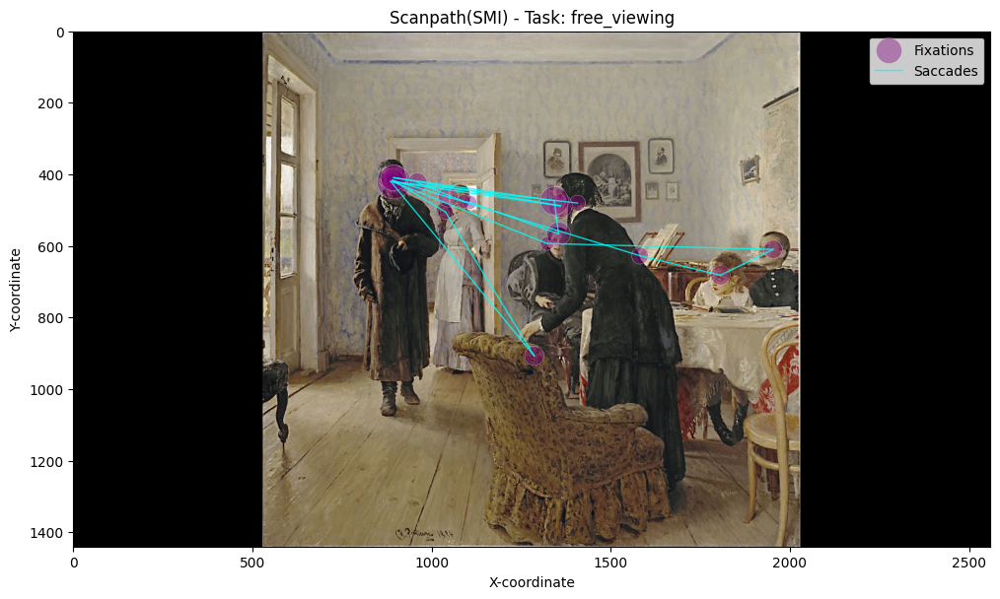


Metrics for estimate_wealth Task:
                                Metric   Value
0  Average Fixation Duration (seconds)    0.33
1      Average Saccade Length (pixels)  368.49
2            Total Number of Fixations      14
3    Total Scanpath Duration (seconds)    9.91


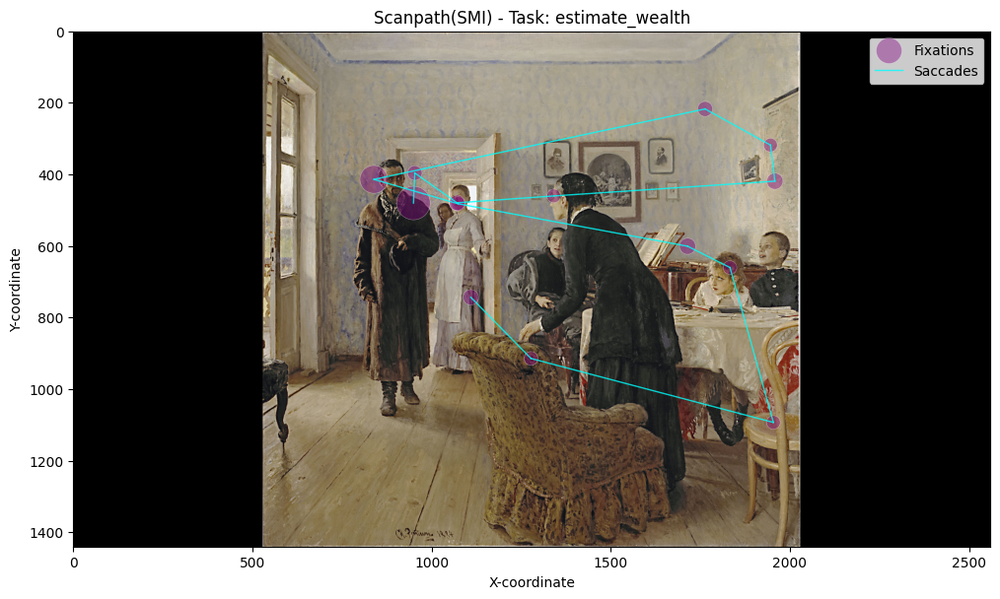


Metrics for age_estimation Task:
                                Metric   Value
0  Average Fixation Duration (seconds)    0.55
1      Average Saccade Length (pixels)  153.86
2            Total Number of Fixations      12
3    Total Scanpath Duration (seconds)    9.64


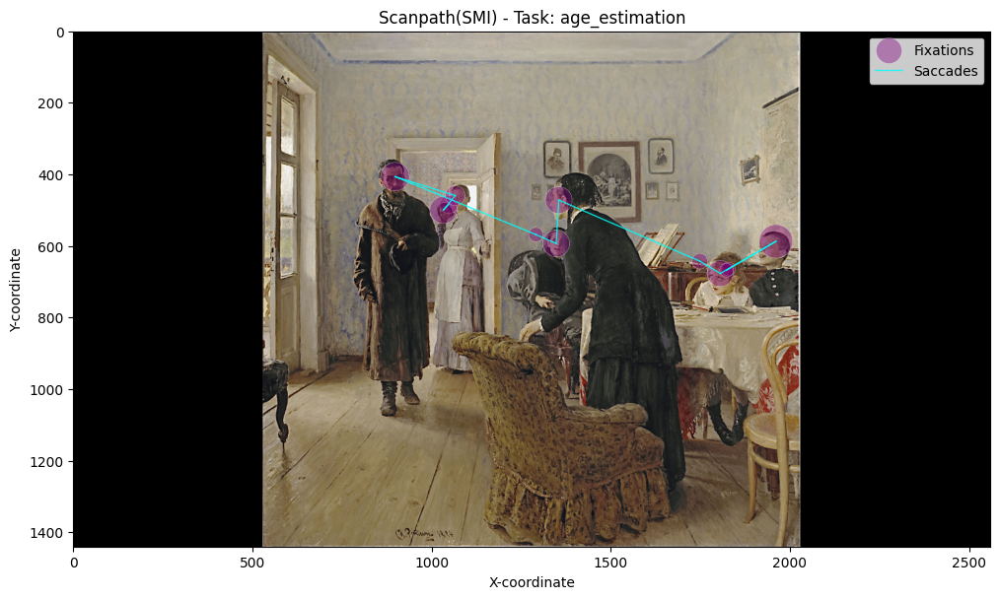


Metrics for activity Task:
                                Metric   Value
0  Average Fixation Duration (seconds)    0.38
1      Average Saccade Length (pixels)  190.29
2            Total Number of Fixations      13
3    Total Scanpath Duration (seconds)    8.94


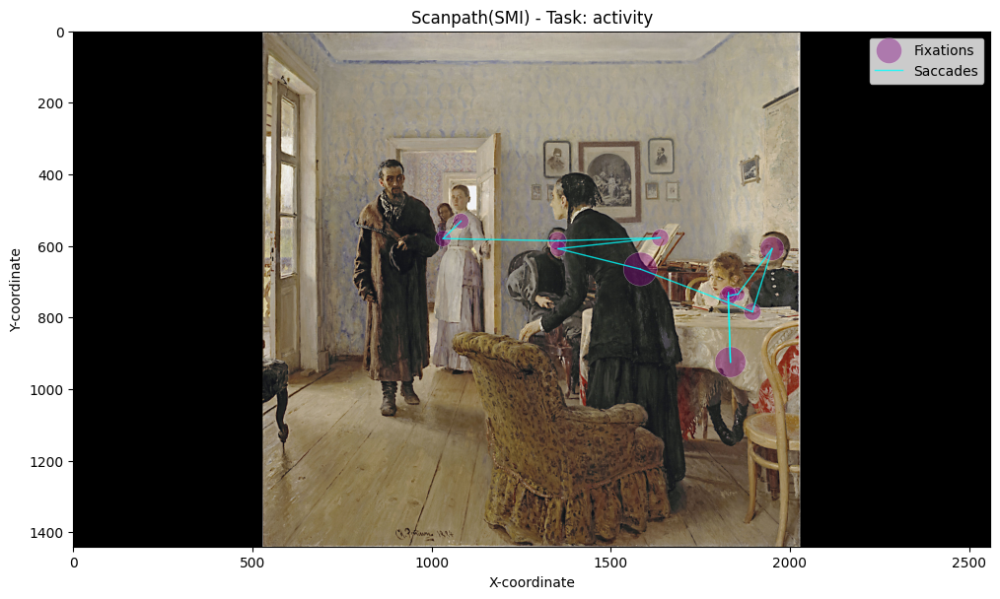


Metrics for remember_clothes Task:
                                Metric   Value
0  Average Fixation Duration (seconds)    0.24
1      Average Saccade Length (pixels)  200.15
2            Total Number of Fixations      17
3    Total Scanpath Duration (seconds)    9.91


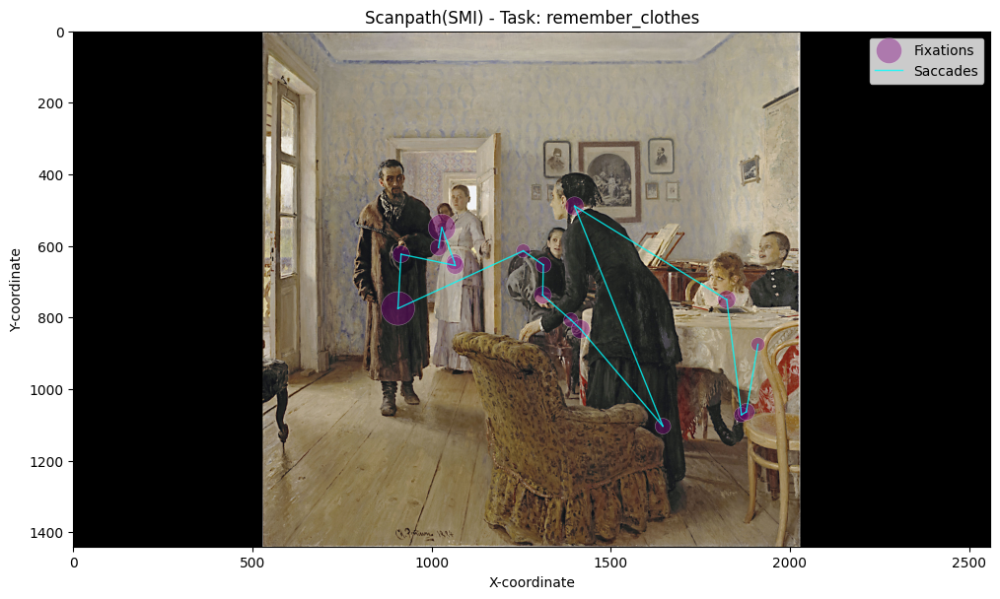


Metrics for furniture Task:
                                Metric   Value
0  Average Fixation Duration (seconds)    0.13
1      Average Saccade Length (pixels)  261.71
2            Total Number of Fixations      19
3    Total Scanpath Duration (seconds)    9.61


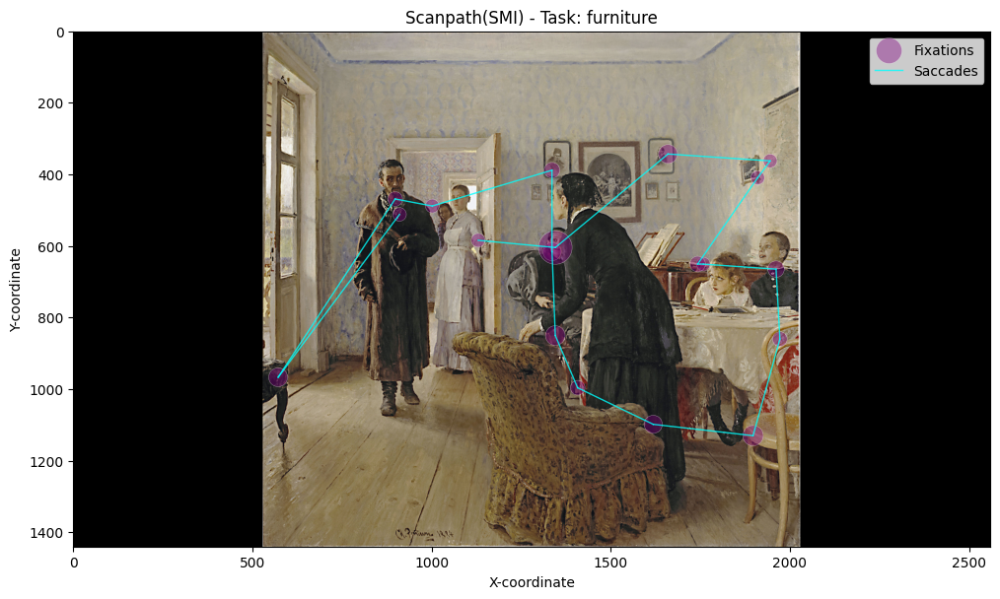

In [33]:
for task_name, df in dfs_fixations_smi.items():

    # 1. Calculate Average Fixation Duration
    average_fixation_duration = df['duration'].mean()

    # 2. Calculate Saccade Lengths (distance between consecutive fixations)
    x_diff = df['x'].diff().iloc[1:]  # Differences in x coordinates
    y_diff = df['y'].diff().iloc[1:]  # Differences in y coordinates
    saccade_lengths = np.sqrt(x_diff**2 + y_diff**2)  # Euclidean distance between consecutive fixations

    # 3. Calculate the Average Saccade Length
    average_saccade_length = saccade_lengths.mean()

    # 4. Calculate Total Number of Fixations
    total_fixations = len(df)

    # 5. Calculate Total Scanpath Duration
    total_scanpath_duration = df['time_end'].max() - df['time_start'].min()

    # 6. Prepare metrics for display
    metrics = {
        "Metric": [
            "Average Fixation Duration (seconds)",
            "Average Saccade Length (pixels)",
            "Total Number of Fixations",
            "Total Scanpath Duration (seconds)"
        ],
        "Value": [
            f"{average_fixation_duration:.2f}",
            f"{average_saccade_length:.2f}",
            total_fixations,
            f"{total_scanpath_duration:.2f}"
        ]
    }

    metrics_df = pd.DataFrame(metrics)
    print(f"\nMetrics for {task_name} Task:")
    print(metrics_df)

    min_time = df['duration'].min()
    max_time = df['duration'].max()

    # Normalize fixation durations to assign circle sizes proportionally
    size_range = (100, 600)
    df['size'] = (df['duration'] - min_time) / (max_time - min_time) * (size_range[1] - size_range[0]) + size_range[0]

    # # Range for transparency of circle
    # alpha_range = (0.4, 0.8)
    # df['alpha'] = (df['duration'] - min_time) / (max_time - min_time) * (alpha_range[1] - alpha_range[0]) + alpha_range[0]

    # Plotting Fixations
    plt.figure(figsize=(12, 8))
    plt.imshow(img)  # Ensure `img` is the image you're using for the background

    # Scatter plot for fixations
    # plt.scatter(df['x'], df['y'], label='Fixations', marker='o', s=df['size'], color='purple', alpha=df['alpha'], edgecolor='white', linewidth= 0.4)
    plt.scatter(df['x'], df['y'], label='Fixations', marker='o', s=df['size'], color='purple', alpha=0.4, edgecolor='white', linewidth= 0.4)

    # Plot saccades (lines between consecutive fixations)
    plotted_saccades = False  # Flag to add saccades label only once
    for i in range(1, len(df)):
        x1, y1 = df['x'].iloc[i - 1], df['y'].iloc[i - 1]
        x2, y2 = df['x'].iloc[i], df['y'].iloc[i]
        if not plotted_saccades:  # Add label for saccades only once
            plt.plot([x1, x2], [y1, y2], color='cyan',linestyle='-', linewidth=1, alpha=0.8, label='Saccades')
            plotted_saccades = True
        else:
            plt.plot([x1, x2], [y1, y2], color='cyan', linestyle='-', linewidth=1, alpha=0.8)

    # Titles and labels
    # plt.title(f'Fixation Visualization for {task_name} Task')
    plt.title(f"Scanpath(SMI) - Task: {task_name}")
    plt.xlabel('X-coordinate')
    plt.ylabel('Y-coordinate')
    plt.xlim(0,2560)#set x axis limits
    plt.ylim(1440,0)#set y axis limits
    plt.legend()
    plt.grid(False)  
    plt.axis('on') 
    plt.show()

## Observation

The scanpaths for different tasks show that fixation patterns are closely linked to the nature of the task. 

### I-DT

#### Free Viewing Task
This task required observer to see everywhere in image and therefore fixations are spread relatively evenly across multiple points of interest within the scene. The average fixation duration is quite low and the saccade lengths are relatively short with 122.47 pixels, showing that the viewers' gazes moved frequently but not very far.
#### Estimate Wealth Task: 
This task required observer to look at people and guess how wealthy they are. The result shows fewer fixations with longer saccade lengths compared to the free-viewing task. The viewer seemed to focus more on the characters and their belongings, and trying to discern social status or wealth based on clothing and interactions.
#### Age Estimation Task: 
This task required observer to estimate the age of people in image. The fixations are numerous and concentrated around the faces and bodies of the characters, likely as viewer attempted to determine the age of each figure. Viewer concerned just the faces of people, so that the result shows it short in saccade lengths.
#### Activity Task: 
This task result have fixations centered more on the characters engaged in activities, like the woman bending over the chair. The spread of fixations is medium, indicating a focused yet exploratory pattern as viewers tried to understand the context of the activities.
#### Remember Clothes Task: 
This task asked observer to remember the clothes of people.　Therefore, fixations are concentrated on the characters, particularly their clothing. Same as age estimation task, viewer concentrated to small part of image such as clothes, result in the short in saccade lengths and high number of fixations.
#### Furniture Task: 
This task ask observer to look at the furniture. Fixations are targeted not only at the characters but also at the furniture. The saccades are somewhat longer here, showing a broader range of attention possibly to see completely.

### SMI

#### Free Viewing Task
In the free viewing task, the focus was generally on faces, reflecting a natural human tendency to pay attention to socially important features.
#### Estimate Wealth Task: 
During the wealth estimation task, fixations were directed toward details like the interiors of houses and the outfits of people, likely because these provide clues about socioeconomic status.
#### Age Estimation Task: 
In the age estimation task, attention was primarily on faces, as facial features like wrinkles and structure are essential for judging age.
#### Activity Task: 
For the activity task, the focus shifted to people’s bodies, as posture and movement offer key insights into actions.
#### Remember Clothes Task: 
In the remembering clothes task, participants concentrated on outfits.
#### Furniture Task: 
In the furniture task, the scanpaths showed that the eyes actively searched the interior for pieces of furniture and fixated on them once identified.



These patterns highlight how visual attention adapts to the specific requirements of each task, demonstrating the close relation between what we see and what we aim to achieve.

### Comparison between I-DT and SMI
We implemented two algorithms for comparison in the Final project. We confirmed some differences in scan path visualization. Both position and numbers of fixation and saccades are different between the I-DT algorithm and the SMI algorithm. We will discuss more details in the Final project.
Note that these results depend on setting parameters, such as the thresholds, and the saccade peak width. We need to fine-tune the parameters of the SMI algorithm, as sometimes, the velocity detected is not high enough to be a saccade, but the eye moves too much to be a fixation, and this is just seen as one fixation. Take for example in the SMI case in the task of estimating welth, you can see that the man on the left has many crosses in the output of the algorithm. This is because the subject did a "scan" of the person, not too fast, but also not stopping in any place, so the entire pass in the person is detected as 1 fixation long in the visualization (which is missleading).